### Estudos para o protótipo 

Este notebook descreve os primeiros experimentos com os vídeos enviados pelo Tarcísio dia 11/04/2019.

Os objetivos deste teste são:

- detectar as bordas da placa
- detectar quando a região de solda está passando pelo vídeo

#### 1. Detectar as bordas da placa

Pegar o ponto central do vídeo e a partir dele selecionar os pixels que não variem em cor e intensidade menos que um certo threshold.

A partir daí, colorir todos os pixels que fizerem fronteira com a borda.

#### 1.1. Converter para preto e branco

A função [rgb2gray](https://scikit-image.org/docs/dev/api/skimage.color.html#skimage.color.rgb2gray) converte a imagem para preto e branco com base na fórmula:

Y = 0.2125 R + 0.7154 G + 0.0721 B

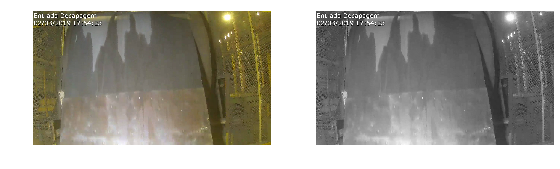

In [365]:
import skvideo.io
from skimage.feature import canny
from skimage.color import rgb2gray
from skimage import exposure
import matplotlib.pyplot as plt

reader = skvideo.io.FFmpegReader('./raw_videos/solda_25.avi')
for _ in range(920):
    next(reader.nextFrame())

first_frame = next(reader.nextFrame())
original = first_frame.copy()
grayscale = rgb2gray(original)

# Py plot.
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

ax[0].imshow(original)
ax[0].axis('off')
ax[1].imshow(grayscale, cmap=plt.cm.gray)
ax[1].axis('off')

fig.tight_layout()
plt.show()

#### Aumentar Contraste

Existem várias formas de aumentar o contraste sem perder informação. Esta etapa ajuda a salientar as bordas.

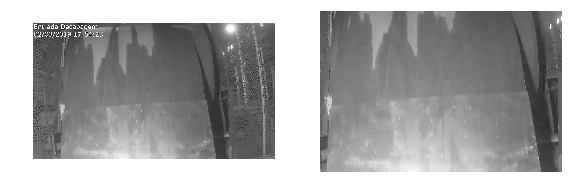

In [366]:
from skimage.color import rgb2gray
from skimage import exposure
import matplotlib.pyplot as plt

original = grayscale.copy()
img = exposure.adjust_log(original, 1)
# img = exposure.adjust_gamma(original, 2)
# img = exposure.rescale_intensity(original)

img = img[100:,120:1050]

# Py plot.
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

ax[0].imshow(original, cmap=plt.cm.gray)
ax[0].axis('off')
ax[1].imshow(img, cmap=plt.cm.gray)
ax[1].axis('off')

fig.tight_layout()
plt.show()

#### Detecção de bordas

O algoritmo de detecção de bordas é muito simples. Ele parte do centro da imagem e detecta a primeira mudança de contraste significativa, chando a borda naquele ponto. Depois a linha é suavizada com a média móvel dos pontos de baixo para cima. 

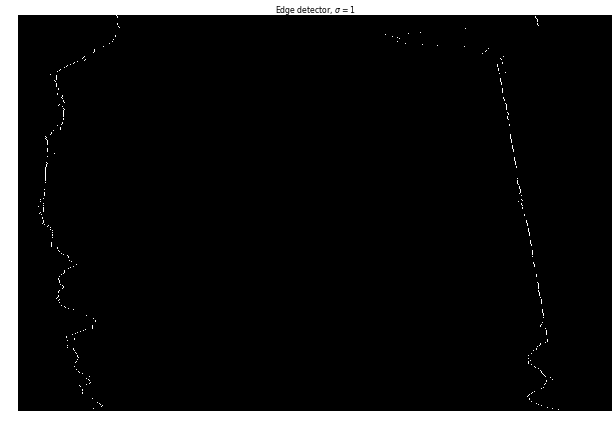

In [367]:
from skimage import feature
from scipy import ndimage as ndi
from skimage.filters import sobel

def get_edge(img, trigger=0.05, window=7, lft=False):
    edge = np.zeros(img.shape[0], dtype=int)

    for y in range(img.shape[0]):
        mid_point = img.shape[1] // 2
        
        if lft:
            rng = reversed(range(20, mid_point - 300))
        else:
            rng = range(mid_point + 200, img.shape[1]-50)
            
        # For each horizontal line.
        for x in rng:
            pixels_before = np.mean(img[y,x-window:x])
            pixels_after  = np.mean(img[y,x:x+window])
            
            contrast = abs(pixels_before - pixels_after)
            if contrast > trigger:
                edge[y] = x
                break
    return edge

def smooth(edge, window=20):
    for y in reversed(range(img.shape[0]-1)): 
        avg = np.mean(edge[y-window:y+window]) 
        if abs(edge[y] - avg) > 10:
            edge[y] = avg
   
def draw_edges(img):
    edge1 = get_edge(img, trigger=0.03, lft=True)
    edge2 = get_edge(img, trigger=0.07, lft=False)
    smooth(edge1)
    smooth(edge2)    

    new_img = np.zeros_like(img)
    for y in range(img.shape[0]):
        new_img[y, edge1[y]] = 255
        new_img[y, edge2[y]] = 255
    return new_img

edges = draw_edges(img)
    
# display results
# fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(8, 3), sharex=True, sharey=True)
fig, ax2 = plt.subplots(nrows=1, ncols=1, figsize=(620/40, 930/40), dpi=40)

# ax1.imshow(img, cmap=plt.cm.gray)
# ax1.axis('off')
# ax1.set_title('Original', fontsize=14)

ax2.imshow(edges, cmap=plt.cm.gray)
ax2.axis('off')
ax2.set_title('Edge detector, $\sigma=1$', fontsize=14)

fig.tight_layout()
plt.show()

### Detectar bordas no filme

In [289]:
import skvideo.io
import imageio
from skimage.color import rgb2gray
from skimage import exposure

reader = skvideo.io.FFmpegReader('./raw_videos/solda_25.avi')
writer = skvideo.io.FFmpegWriter('./processed_videos/solda_25.mp4')

def process_frame(frame):
    original = frame.copy()
    
    gray = rgb2gray(frame.copy())
    gray = exposure.adjust_log(gray, 1)
    gray = gray[100:,120:1050]
    original = original[100:,120:1050]
    
    edge1 = get_edge(gray, trigger=0.03, lft=True)
    edge2 = get_edge(gray, trigger=0.07, lft=False)
    smooth(edge1)
    smooth(edge2)    

    for y in range(original.shape[0]):
        original[y, edge1[y]] = [255,0,0]
        original[y, edge2[y]] = [255,0,0]
    return original[100:-100]

(num_frames, _, _, _) = reader.getShape()

counter = 0
for frame in reader.nextFrame():
    frame = process_frame(frame)
    writer.writeFrame(frame)
    
    counter += 1
    print('Processed %d of %d frames' % (counter, num_frames))
    # if counter > 10:
    #     break
writer.close()

Processed 1 of 1372 frames
Processed 2 of 1372 frames
Processed 3 of 1372 frames
Processed 4 of 1372 frames
Processed 5 of 1372 frames
Processed 6 of 1372 frames
Processed 7 of 1372 frames
Processed 8 of 1372 frames
Processed 9 of 1372 frames
Processed 10 of 1372 frames
Processed 11 of 1372 frames
Processed 12 of 1372 frames
Processed 13 of 1372 frames
Processed 14 of 1372 frames
Processed 15 of 1372 frames
Processed 16 of 1372 frames
Processed 17 of 1372 frames
Processed 18 of 1372 frames
Processed 19 of 1372 frames
Processed 20 of 1372 frames
Processed 21 of 1372 frames
Processed 22 of 1372 frames
Processed 23 of 1372 frames
Processed 24 of 1372 frames
Processed 25 of 1372 frames
Processed 26 of 1372 frames
Processed 27 of 1372 frames
Processed 28 of 1372 frames
Processed 29 of 1372 frames
Processed 30 of 1372 frames
Processed 31 of 1372 frames
Processed 32 of 1372 frames
Processed 33 of 1372 frames
Processed 34 of 1372 frames
Processed 35 of 1372 frames
Processed 36 of 1372 frames
P

Processed 288 of 1372 frames
Processed 289 of 1372 frames
Processed 290 of 1372 frames
Processed 291 of 1372 frames
Processed 292 of 1372 frames
Processed 293 of 1372 frames
Processed 294 of 1372 frames
Processed 295 of 1372 frames
Processed 296 of 1372 frames
Processed 297 of 1372 frames
Processed 298 of 1372 frames
Processed 299 of 1372 frames
Processed 300 of 1372 frames
Processed 301 of 1372 frames
Processed 302 of 1372 frames
Processed 303 of 1372 frames
Processed 304 of 1372 frames
Processed 305 of 1372 frames
Processed 306 of 1372 frames
Processed 307 of 1372 frames
Processed 308 of 1372 frames
Processed 309 of 1372 frames
Processed 310 of 1372 frames
Processed 311 of 1372 frames
Processed 312 of 1372 frames
Processed 313 of 1372 frames
Processed 314 of 1372 frames
Processed 315 of 1372 frames
Processed 316 of 1372 frames
Processed 317 of 1372 frames
Processed 318 of 1372 frames
Processed 319 of 1372 frames
Processed 320 of 1372 frames
Processed 321 of 1372 frames
Processed 322 

Processed 571 of 1372 frames
Processed 572 of 1372 frames
Processed 573 of 1372 frames
Processed 574 of 1372 frames
Processed 575 of 1372 frames
Processed 576 of 1372 frames
Processed 577 of 1372 frames
Processed 578 of 1372 frames
Processed 579 of 1372 frames
Processed 580 of 1372 frames
Processed 581 of 1372 frames
Processed 582 of 1372 frames
Processed 583 of 1372 frames
Processed 584 of 1372 frames
Processed 585 of 1372 frames
Processed 586 of 1372 frames
Processed 587 of 1372 frames
Processed 588 of 1372 frames
Processed 589 of 1372 frames
Processed 590 of 1372 frames
Processed 591 of 1372 frames
Processed 592 of 1372 frames
Processed 593 of 1372 frames
Processed 594 of 1372 frames
Processed 595 of 1372 frames
Processed 596 of 1372 frames
Processed 597 of 1372 frames
Processed 598 of 1372 frames
Processed 599 of 1372 frames
Processed 600 of 1372 frames
Processed 601 of 1372 frames
Processed 602 of 1372 frames
Processed 603 of 1372 frames
Processed 604 of 1372 frames
Processed 605 

Processed 854 of 1372 frames
Processed 855 of 1372 frames
Processed 856 of 1372 frames
Processed 857 of 1372 frames
Processed 858 of 1372 frames
Processed 859 of 1372 frames
Processed 860 of 1372 frames
Processed 861 of 1372 frames
Processed 862 of 1372 frames
Processed 863 of 1372 frames
Processed 864 of 1372 frames
Processed 865 of 1372 frames
Processed 866 of 1372 frames
Processed 867 of 1372 frames
Processed 868 of 1372 frames
Processed 869 of 1372 frames
Processed 870 of 1372 frames
Processed 871 of 1372 frames
Processed 872 of 1372 frames
Processed 873 of 1372 frames
Processed 874 of 1372 frames
Processed 875 of 1372 frames
Processed 876 of 1372 frames
Processed 877 of 1372 frames
Processed 878 of 1372 frames
Processed 879 of 1372 frames
Processed 880 of 1372 frames
Processed 881 of 1372 frames
Processed 882 of 1372 frames
Processed 883 of 1372 frames
Processed 884 of 1372 frames
Processed 885 of 1372 frames
Processed 886 of 1372 frames
Processed 887 of 1372 frames
Processed 888 

Processed 1132 of 1372 frames
Processed 1133 of 1372 frames
Processed 1134 of 1372 frames
Processed 1135 of 1372 frames
Processed 1136 of 1372 frames
Processed 1137 of 1372 frames
Processed 1138 of 1372 frames
Processed 1139 of 1372 frames
Processed 1140 of 1372 frames
Processed 1141 of 1372 frames
Processed 1142 of 1372 frames
Processed 1143 of 1372 frames
Processed 1144 of 1372 frames
Processed 1145 of 1372 frames
Processed 1146 of 1372 frames
Processed 1147 of 1372 frames
Processed 1148 of 1372 frames
Processed 1149 of 1372 frames
Processed 1150 of 1372 frames
Processed 1151 of 1372 frames
Processed 1152 of 1372 frames
Processed 1153 of 1372 frames
Processed 1154 of 1372 frames
Processed 1155 of 1372 frames
Processed 1156 of 1372 frames
Processed 1157 of 1372 frames
Processed 1158 of 1372 frames
Processed 1159 of 1372 frames
Processed 1160 of 1372 frames
Processed 1161 of 1372 frames
Processed 1162 of 1372 frames
Processed 1163 of 1372 frames
Processed 1164 of 1372 frames
Processed 

In [290]:
import io
import base64
from IPython.display import HTML

video = io.open('processed_videos/solda_25.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(
    data='''
        <video alt="test" style="width: 100%;" controls>
            <source src="data:video/mp4;base64,{0}" type="video/mp4" />
        </video>
    '''.format(encoded.decode('ascii'))
)

#### 2. Detectar quando a região de solda está passando pelo vídeo

Gerar uma distribuição de probabilidade por frame dizendo se aquele frame contém ou não uma região de solda.

(420, 930, 3)


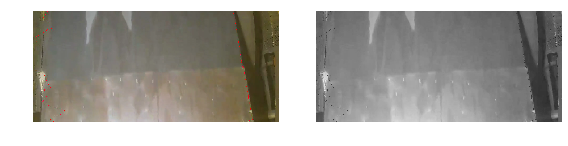

In [340]:
import skvideo.io
import imageio
from skimage.color import rgb2gray
from skimage import exposure
import matplotlib.pyplot as plt

reader = skvideo.io.FFmpegReader('./processed_videos/solda_25.mp4')

# for _ in range(80):
for _ in range(920):
    next(reader.nextFrame())

first_frame = next(reader.nextFrame())
print(first_frame.shape)

original = first_frame.copy()
grayscale = rgb2gray(original)
img = exposure.adjust_log(grayscale, 1)

# Py plot.
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

ax[0].imshow(original, cmap=plt.cm.gray)
ax[0].axis('off')
ax[1].imshow(img, cmap=plt.cm.gray)
ax[1].axis('off')

fig.tight_layout()
plt.show()

149.21333333333334


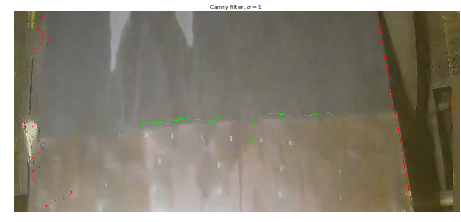

In [331]:
def detect_weld(img, trigger=0.03, window=15):
    edge = np.zeros(img.shape[1], dtype=int)

    for x in range(265, 665):
        for y in range(200, 400):
            pixels_before = np.mean(img[y-window:y,x])
            pixels_after  = np.mean(img[y:y+window,x])
            
            contrast = abs(pixels_before - pixels_after)
            if contrast > trigger:
                edge[x] = y
                break
    return edge

new_frame = original.copy()
edge = detect_weld(img)

avg = np.sum(edge) / 600.0
print(avg)

for x in range(img.shape[1]):
    new_frame[edge[x], x] = [0,255,0]
    new_frame[int(avg), x] = [0,0,255]

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(620/40, 930/40), dpi=30)
ax.imshow(new_frame, cmap=plt.cm.gray)
ax.axis('off')
ax.set_title('Canny filter, $\sigma=1$', fontsize=14)

fig.tight_layout()
plt.show()

### Detect weld

In [345]:
import skvideo.io
import imageio
from skimage.color import rgb2gray
from skimage import exposure

reader = skvideo.io.FFmpegReader('./processed_videos/solda_25.mp4')
writer = skvideo.io.FFmpegWriter('./processed_videos/solda_25a.mp4')

def draw_dot(frame, x, y, size, color=[255,0,0]):
    for x_ in range(x-size,x+size):
        for y_ in range(y-size, y+size):
            frame[y_, x_] = color
    return frame

def process_frame(frame):  
    new_frame = frame.copy()
    grayscale = rgb2gray(frame.copy())
    grayscale = exposure.adjust_log(grayscale, 1)
    edge = detect_weld(grayscale)

    avg = np.sum(edge) / 600.0
    
    draw_dot(new_frame, 460, 205, 5, color=[255,255,255])
    if avg > 100:
        draw_dot(new_frame, 460, 205, 5, color=[0,255,0])
        for x in range(img.shape[1]):
            new_frame[edge[x], x] = [0,255,0]

    return new_frame

(num_frames, _, _, _) = reader.getShape()

counter = 0
for frame in reader.nextFrame():
    frame = process_frame(frame)
    writer.writeFrame(frame)     
    counter += 1
    print('Processed %d of %d frames' % (counter, num_frames))     
writer.close()

Processed 1 of 1372 frames
Processed 2 of 1372 frames
Processed 3 of 1372 frames
Processed 4 of 1372 frames
Processed 5 of 1372 frames
Processed 6 of 1372 frames
Processed 7 of 1372 frames
Processed 8 of 1372 frames
Processed 9 of 1372 frames
Processed 10 of 1372 frames
Processed 11 of 1372 frames
Processed 12 of 1372 frames
Processed 13 of 1372 frames
Processed 14 of 1372 frames
Processed 15 of 1372 frames
Processed 16 of 1372 frames
Processed 17 of 1372 frames
Processed 18 of 1372 frames
Processed 19 of 1372 frames
Processed 20 of 1372 frames
Processed 21 of 1372 frames
Processed 22 of 1372 frames
Processed 23 of 1372 frames
Processed 24 of 1372 frames
Processed 25 of 1372 frames
Processed 26 of 1372 frames
Processed 27 of 1372 frames
Processed 28 of 1372 frames
Processed 29 of 1372 frames
Processed 30 of 1372 frames
Processed 31 of 1372 frames
Processed 32 of 1372 frames
Processed 33 of 1372 frames
Processed 34 of 1372 frames
Processed 35 of 1372 frames
Processed 36 of 1372 frames
P

Processed 288 of 1372 frames
Processed 289 of 1372 frames
Processed 290 of 1372 frames
Processed 291 of 1372 frames
Processed 292 of 1372 frames
Processed 293 of 1372 frames
Processed 294 of 1372 frames
Processed 295 of 1372 frames
Processed 296 of 1372 frames
Processed 297 of 1372 frames
Processed 298 of 1372 frames
Processed 299 of 1372 frames
Processed 300 of 1372 frames
Processed 301 of 1372 frames
Processed 302 of 1372 frames
Processed 303 of 1372 frames
Processed 304 of 1372 frames
Processed 305 of 1372 frames
Processed 306 of 1372 frames
Processed 307 of 1372 frames
Processed 308 of 1372 frames
Processed 309 of 1372 frames
Processed 310 of 1372 frames
Processed 311 of 1372 frames
Processed 312 of 1372 frames
Processed 313 of 1372 frames
Processed 314 of 1372 frames
Processed 315 of 1372 frames
Processed 316 of 1372 frames
Processed 317 of 1372 frames
Processed 318 of 1372 frames
Processed 319 of 1372 frames
Processed 320 of 1372 frames
Processed 321 of 1372 frames
Processed 322 

Processed 571 of 1372 frames
Processed 572 of 1372 frames
Processed 573 of 1372 frames
Processed 574 of 1372 frames
Processed 575 of 1372 frames
Processed 576 of 1372 frames
Processed 577 of 1372 frames
Processed 578 of 1372 frames
Processed 579 of 1372 frames
Processed 580 of 1372 frames
Processed 581 of 1372 frames
Processed 582 of 1372 frames
Processed 583 of 1372 frames
Processed 584 of 1372 frames
Processed 585 of 1372 frames
Processed 586 of 1372 frames
Processed 587 of 1372 frames
Processed 588 of 1372 frames
Processed 589 of 1372 frames
Processed 590 of 1372 frames
Processed 591 of 1372 frames
Processed 592 of 1372 frames
Processed 593 of 1372 frames
Processed 594 of 1372 frames
Processed 595 of 1372 frames
Processed 596 of 1372 frames
Processed 597 of 1372 frames
Processed 598 of 1372 frames
Processed 599 of 1372 frames
Processed 600 of 1372 frames
Processed 601 of 1372 frames
Processed 602 of 1372 frames
Processed 603 of 1372 frames
Processed 604 of 1372 frames
Processed 605 

Processed 854 of 1372 frames
Processed 855 of 1372 frames
Processed 856 of 1372 frames
Processed 857 of 1372 frames
Processed 858 of 1372 frames
Processed 859 of 1372 frames
Processed 860 of 1372 frames
Processed 861 of 1372 frames
Processed 862 of 1372 frames
Processed 863 of 1372 frames
Processed 864 of 1372 frames
Processed 865 of 1372 frames
Processed 866 of 1372 frames
Processed 867 of 1372 frames
Processed 868 of 1372 frames
Processed 869 of 1372 frames
Processed 870 of 1372 frames
Processed 871 of 1372 frames
Processed 872 of 1372 frames
Processed 873 of 1372 frames
Processed 874 of 1372 frames
Processed 875 of 1372 frames
Processed 876 of 1372 frames
Processed 877 of 1372 frames
Processed 878 of 1372 frames
Processed 879 of 1372 frames
Processed 880 of 1372 frames
Processed 881 of 1372 frames
Processed 882 of 1372 frames
Processed 883 of 1372 frames
Processed 884 of 1372 frames
Processed 885 of 1372 frames
Processed 886 of 1372 frames
Processed 887 of 1372 frames
Processed 888 

Processed 1132 of 1372 frames
Processed 1133 of 1372 frames
Processed 1134 of 1372 frames
Processed 1135 of 1372 frames
Processed 1136 of 1372 frames
Processed 1137 of 1372 frames
Processed 1138 of 1372 frames
Processed 1139 of 1372 frames
Processed 1140 of 1372 frames
Processed 1141 of 1372 frames
Processed 1142 of 1372 frames
Processed 1143 of 1372 frames
Processed 1144 of 1372 frames
Processed 1145 of 1372 frames
Processed 1146 of 1372 frames
Processed 1147 of 1372 frames
Processed 1148 of 1372 frames
Processed 1149 of 1372 frames
Processed 1150 of 1372 frames
Processed 1151 of 1372 frames
Processed 1152 of 1372 frames
Processed 1153 of 1372 frames
Processed 1154 of 1372 frames
Processed 1155 of 1372 frames
Processed 1156 of 1372 frames
Processed 1157 of 1372 frames
Processed 1158 of 1372 frames
Processed 1159 of 1372 frames
Processed 1160 of 1372 frames
Processed 1161 of 1372 frames
Processed 1162 of 1372 frames
Processed 1163 of 1372 frames
Processed 1164 of 1372 frames
Processed 

In [346]:
import io
import base64
from IPython.display import HTML

video = io.open('processed_videos/solda_25a.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(
    data='''
        <video alt="test" style="width: 100%;" controls>
            <source src="data:video/mp4;base64,{0}" type="video/mp4" />
        </video>
    '''.format(encoded.decode('ascii'))
)

In [360]:
import skvideo.io
import imageio
from skimage.color import rgb2gray
from skimage import exposure

reader = skvideo.io.FFmpegReader('./raw_videos/solda_24.avi')
writer = skvideo.io.FFmpegWriter('./processed_videos/solda_24a.mp4')

def process_frame(frame):
    original = frame.copy()
    
    gray = rgb2gray(frame.copy())
    gray = exposure.adjust_log(gray, 1)
    gray = gray[100:,120:1050]
    original = original[100:,120:1050]
    
    edge1 = get_edge(gray, trigger=0.018, lft=True)
    edge2 = get_edge(gray, trigger=0.07, lft=False)
    smooth(edge1)
    smooth(edge2)    

    for y in range(original.shape[0]):
        original[y, edge1[y]] = [255,0,0]
        original[y, edge2[y]] = [255,0,0]
    original = original[100:-100]  
        
    edge3 = detect_weld(gray[100:-100])
    avg = np.sum(edge3) / 600.0
    
    draw_dot(original, 460, 205, 5, color=[255,255,255])
    if avg > 100:
        draw_dot(original, 460, 205, 5, color=[0,255,0])
        for x in range(img.shape[1]):
            original[edge3[x], x] = [0,255,0]           
    return original

(num_frames, _, _, _) = reader.getShape()

counter = 0
for frame in reader.nextFrame():
    frame = process_frame(frame)
    writer.writeFrame(frame)
    
    counter += 1
    print('Processed %d of %d frames' % (counter, num_frames))
    # if counter > 10:
    #     break
writer.close()

Processed 1 of 1842 frames
Processed 2 of 1842 frames
Processed 3 of 1842 frames
Processed 4 of 1842 frames
Processed 5 of 1842 frames
Processed 6 of 1842 frames
Processed 7 of 1842 frames
Processed 8 of 1842 frames
Processed 9 of 1842 frames
Processed 10 of 1842 frames
Processed 11 of 1842 frames
Processed 12 of 1842 frames
Processed 13 of 1842 frames
Processed 14 of 1842 frames
Processed 15 of 1842 frames
Processed 16 of 1842 frames
Processed 17 of 1842 frames
Processed 18 of 1842 frames
Processed 19 of 1842 frames
Processed 20 of 1842 frames
Processed 21 of 1842 frames
Processed 22 of 1842 frames
Processed 23 of 1842 frames
Processed 24 of 1842 frames
Processed 25 of 1842 frames
Processed 26 of 1842 frames
Processed 27 of 1842 frames
Processed 28 of 1842 frames
Processed 29 of 1842 frames
Processed 30 of 1842 frames
Processed 31 of 1842 frames
Processed 32 of 1842 frames
Processed 33 of 1842 frames
Processed 34 of 1842 frames
Processed 35 of 1842 frames
Processed 36 of 1842 frames
P

Processed 288 of 1842 frames
Processed 289 of 1842 frames
Processed 290 of 1842 frames
Processed 291 of 1842 frames
Processed 292 of 1842 frames
Processed 293 of 1842 frames
Processed 294 of 1842 frames
Processed 295 of 1842 frames
Processed 296 of 1842 frames
Processed 297 of 1842 frames
Processed 298 of 1842 frames
Processed 299 of 1842 frames
Processed 300 of 1842 frames
Processed 301 of 1842 frames
Processed 302 of 1842 frames
Processed 303 of 1842 frames
Processed 304 of 1842 frames
Processed 305 of 1842 frames
Processed 306 of 1842 frames
Processed 307 of 1842 frames
Processed 308 of 1842 frames
Processed 309 of 1842 frames
Processed 310 of 1842 frames
Processed 311 of 1842 frames
Processed 312 of 1842 frames
Processed 313 of 1842 frames
Processed 314 of 1842 frames
Processed 315 of 1842 frames
Processed 316 of 1842 frames
Processed 317 of 1842 frames
Processed 318 of 1842 frames
Processed 319 of 1842 frames
Processed 320 of 1842 frames
Processed 321 of 1842 frames
Processed 322 

Processed 571 of 1842 frames
Processed 572 of 1842 frames
Processed 573 of 1842 frames
Processed 574 of 1842 frames
Processed 575 of 1842 frames
Processed 576 of 1842 frames
Processed 577 of 1842 frames
Processed 578 of 1842 frames
Processed 579 of 1842 frames
Processed 580 of 1842 frames
Processed 581 of 1842 frames
Processed 582 of 1842 frames
Processed 583 of 1842 frames
Processed 584 of 1842 frames
Processed 585 of 1842 frames
Processed 586 of 1842 frames
Processed 587 of 1842 frames
Processed 588 of 1842 frames
Processed 589 of 1842 frames
Processed 590 of 1842 frames
Processed 591 of 1842 frames
Processed 592 of 1842 frames
Processed 593 of 1842 frames
Processed 594 of 1842 frames
Processed 595 of 1842 frames
Processed 596 of 1842 frames
Processed 597 of 1842 frames
Processed 598 of 1842 frames
Processed 599 of 1842 frames
Processed 600 of 1842 frames
Processed 601 of 1842 frames
Processed 602 of 1842 frames
Processed 603 of 1842 frames
Processed 604 of 1842 frames
Processed 605 

Processed 854 of 1842 frames
Processed 855 of 1842 frames
Processed 856 of 1842 frames
Processed 857 of 1842 frames
Processed 858 of 1842 frames
Processed 859 of 1842 frames
Processed 860 of 1842 frames
Processed 861 of 1842 frames
Processed 862 of 1842 frames
Processed 863 of 1842 frames
Processed 864 of 1842 frames
Processed 865 of 1842 frames
Processed 866 of 1842 frames
Processed 867 of 1842 frames
Processed 868 of 1842 frames
Processed 869 of 1842 frames
Processed 870 of 1842 frames
Processed 871 of 1842 frames
Processed 872 of 1842 frames
Processed 873 of 1842 frames
Processed 874 of 1842 frames
Processed 875 of 1842 frames
Processed 876 of 1842 frames
Processed 877 of 1842 frames
Processed 878 of 1842 frames
Processed 879 of 1842 frames
Processed 880 of 1842 frames
Processed 881 of 1842 frames
Processed 882 of 1842 frames
Processed 883 of 1842 frames
Processed 884 of 1842 frames
Processed 885 of 1842 frames
Processed 886 of 1842 frames
Processed 887 of 1842 frames
Processed 888 

Processed 1132 of 1842 frames
Processed 1133 of 1842 frames
Processed 1134 of 1842 frames
Processed 1135 of 1842 frames
Processed 1136 of 1842 frames
Processed 1137 of 1842 frames
Processed 1138 of 1842 frames
Processed 1139 of 1842 frames
Processed 1140 of 1842 frames
Processed 1141 of 1842 frames
Processed 1142 of 1842 frames
Processed 1143 of 1842 frames
Processed 1144 of 1842 frames
Processed 1145 of 1842 frames
Processed 1146 of 1842 frames
Processed 1147 of 1842 frames
Processed 1148 of 1842 frames
Processed 1149 of 1842 frames
Processed 1150 of 1842 frames
Processed 1151 of 1842 frames
Processed 1152 of 1842 frames
Processed 1153 of 1842 frames
Processed 1154 of 1842 frames
Processed 1155 of 1842 frames
Processed 1156 of 1842 frames
Processed 1157 of 1842 frames
Processed 1158 of 1842 frames
Processed 1159 of 1842 frames
Processed 1160 of 1842 frames
Processed 1161 of 1842 frames
Processed 1162 of 1842 frames
Processed 1163 of 1842 frames
Processed 1164 of 1842 frames
Processed 

Processed 1406 of 1842 frames
Processed 1407 of 1842 frames
Processed 1408 of 1842 frames
Processed 1409 of 1842 frames
Processed 1410 of 1842 frames
Processed 1411 of 1842 frames
Processed 1412 of 1842 frames
Processed 1413 of 1842 frames
Processed 1414 of 1842 frames
Processed 1415 of 1842 frames
Processed 1416 of 1842 frames
Processed 1417 of 1842 frames
Processed 1418 of 1842 frames
Processed 1419 of 1842 frames
Processed 1420 of 1842 frames
Processed 1421 of 1842 frames
Processed 1422 of 1842 frames
Processed 1423 of 1842 frames
Processed 1424 of 1842 frames
Processed 1425 of 1842 frames
Processed 1426 of 1842 frames
Processed 1427 of 1842 frames
Processed 1428 of 1842 frames
Processed 1429 of 1842 frames
Processed 1430 of 1842 frames
Processed 1431 of 1842 frames
Processed 1432 of 1842 frames
Processed 1433 of 1842 frames
Processed 1434 of 1842 frames
Processed 1435 of 1842 frames
Processed 1436 of 1842 frames
Processed 1437 of 1842 frames
Processed 1438 of 1842 frames
Processed 

Processed 1680 of 1842 frames
Processed 1681 of 1842 frames
Processed 1682 of 1842 frames
Processed 1683 of 1842 frames
Processed 1684 of 1842 frames
Processed 1685 of 1842 frames
Processed 1686 of 1842 frames
Processed 1687 of 1842 frames
Processed 1688 of 1842 frames
Processed 1689 of 1842 frames
Processed 1690 of 1842 frames
Processed 1691 of 1842 frames
Processed 1692 of 1842 frames
Processed 1693 of 1842 frames
Processed 1694 of 1842 frames
Processed 1695 of 1842 frames
Processed 1696 of 1842 frames
Processed 1697 of 1842 frames
Processed 1698 of 1842 frames
Processed 1699 of 1842 frames
Processed 1700 of 1842 frames
Processed 1701 of 1842 frames
Processed 1702 of 1842 frames
Processed 1703 of 1842 frames
Processed 1704 of 1842 frames
Processed 1705 of 1842 frames
Processed 1706 of 1842 frames
Processed 1707 of 1842 frames
Processed 1708 of 1842 frames
Processed 1709 of 1842 frames
Processed 1710 of 1842 frames
Processed 1711 of 1842 frames
Processed 1712 of 1842 frames
Processed 

In [362]:
import io
import base64
from IPython.display import HTML

video = io.open('processed_videos/solda_24a.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(
    data='''
        <video alt="test" style="width: 100%;" controls>
            <source src="data:video/mp4;base64,{0}" type="video/mp4" />
        </video>
    '''.format(encoded.decode('ascii'))
)

### Links úteis

- [Machine Learning Video Analysis](https://www.toptal.com/machine-learning/machine-learning-video-analysis)
- [Silhoutte analysis]()
- [CNNs with Andrew Ng](https://www.coursera.org/learn/convolutional-neural-networks)
- [YOLO Object Detection Video](https://www.youtube.com/watch?v=4eIBisqx9_g)
- [Identifying Fish](https://www.toptal.com/machine-learning/machine-learning-video-analysis)